In [1]:
import pandas as pd
from tabulate import tabulate
import numpy as np
import os
from scipy import interpolate
from scipy import stats
import matplotlib.pyplot as plt

Load and Organize Data

In [2]:
times_filename = 'usgs_full_catalog_times_cmt.txt'
extra_info_filename = "usgs_full_catalog_M5_info.txt"
main_event_times_filename = 'usgs_full_catalog_M5_times.txt'
main_events_filename = 'usgs_full_catalog_M5.csv'
times_original = np.loadtxt(times_filename, dtype = str)
times_dt64 = []

for i in times_original:
    times_dt64.append(np.datetime64(i[0]+'T'+i[1])) # Convert times to numpy datetime64
grand_times = np.array(times_dt64)
extra_info = np.loadtxt(extra_info_filename,dtype = object)

main_events = np.loadtxt(main_events_filename,skiprows = 1, delimiter = ',')
main_times_original = np.loadtxt(main_event_times_filename, dtype = str)
times_dt64_2 = []

for i in main_times_original:
    times_dt64_2.append(np.datetime64(i)) # Convert times to numpy datetime64
main_event_times = np.array(times_dt64_2)
offshore_indicies = [1,18,88,101,102,103,129,138,21,22,63,69,100,112] # Indicies for main_events matrix that contains events occuring offshore

r_list = [0.25,0.5,0.75,1,2,3,4,7,15,30,45,60,90,120,150,180,365,730,1095]

In [3]:
def calculate_MatthewsC(P,S):
    """calculate the matthews correlation coefficient.
    Expects a vector of predictions P and observations S.
    The values in P and S.
    P=0 means no larger earthquake earthquake
    P=1 means that we predict a larger earthquake
    P=.05 means 1/20 chance of a larger earthquake"""
    assert(np.shape(S) == np.shape(P))
    sbar = np.mean(S)
    pbar = np.mean(P)
    if pbar == 0 or sbar == 0 or np.std(S) == 0 or np.std(P) == 0:
        return 0
    numerator = np.sum((S-sbar)*(P-pbar))
    denominator = (np.sum((S-sbar)**2)*np.sum((P-pbar)**2))**0.5
    C = numerator/denominator
    return C
def calculate_accuracy(grand_times,csv_data,r_current,extra_info,main_event_times,main_events,r_list,pair_matrix,index,offshore_indicies,default_prob=.90):
    ''' Function takes the results with equivalent end times for a certain parameter combination, determines the 
    sucsess of the TLS score, counts the confusion matrix, and converts to the different success measures. This is repeated for each
    alert threshold within this function, so the output is 5 values for each statistic (f1_list,f2_list,etc), their corresponding confusion
    matricies (conf_list), and the results for each earthquake pair (pair matrix)
    Inputs are the grand_times = complete time data, the csv file for a particular parameter combination = csv_data,
    end time of interest = r_current, the matrix containing event relationships based off the GK window (extra_info),
    times of M5+ events (main_event_times), M5+ catalog (main_events), list of all end times (r_list), the indicies of offshore events, so 
    they may be skipped (offshore_indicies),and the index corresponding to the csv file so that the results are organized 
    correctly. default_prob=.9 this is the default probability that an event is a mainshock.'''
    r_ind = r_list.index(r_current)
    percent_change_column = csv_data.iloc[:,8+(9*r_ind)]
    cat_end_time = np.max(grand_times) # Latest Time in the Catalog
    magnitude_interp = np.arange(2.5,8.5,0.5)
    time_function = interpolate.interp1d(magnitude_interp,np.array([6,11.5,22,42,83,155,290,510,790,915,960,985])) # GK Temporal Window
    conf_list = [] # Confusion Matrix
    f1_list = []
    f2_list = []
    C_list = []
    ktb_list = []
    ba_list = []
    new_index = np.copy(index)
    for threshold in [5,10,15,20,25]: # Loop through Alert Thresholds
        # Initialize confusion matrix quantities
        true_predict = 0 # True Positives, Correct Predictions
        true_nonpredict = 0 # True Negatives, Correct Non-Predictions
        false_predict = 0 # False Negatives, False Predictions
        failed_to_predict = 0 # False Positives, 2nd Event occured with no prediction
        neutral = 0
        early = 0
        insuff = 0
        post_gk_deadline = 0 # Events for which this end-time is past the end of the GK Window
        post_second_event_deadline = 0 # Events for which this end-time is past the mainshock is the event is the first earthquake in a foreshock-mainshock pair
        prediction_list = []
        observation_list = []
        if r_current == 0.25:
            r_datetime = np.timedelta64(6,'h')
        elif r_current == 0.5:
            r_datetime = np.timedelta64(12,'h')
        elif r_current == 0.75:
            r_datetime = np.timedelta64(18,'h')
        else:
            r_datetime = np.timedelta64(r_current,'D')
        pair_event = 0
        for i in range(len(percent_change_column)): # Loop through the results for each event
            if main_event_times[i] < np.datetime64('2011-01-01'):
                continue
            if i in offshore_indicies: # Remove all offshore events from the analysis
                if percent_change_column[i] == 'None': # See if an offshore earthquake generates a score, which would be an interesting finding
                    if extra_info[i,1] == 'yes':  # If the event is a foreshock-mainshock pair, add it to the pair matrix
                        pair_matrix[new_index,pair_event] = 'off'
                        pair_event += 1
                    continue # continue to the top of for loop to skip the offshore earthquake
                else:
                    print('An offshore event has a score: index',i,percent_change_column[i])
                    raise IndexError # Throws an error so one can explore this unexpected outcome
            if np.isnan(main_events[i,-1]) == True: # Skip events with no moment tensor information
                if extra_info[i,1] == 'yes':  # If the event is a foreshock-mainshock pair, add it to the pair matrix
                    pair_matrix[new_index,pair_event] = 'off'
                    pair_event += 1
                continue # continue to the top of for loop to skip the no-moment tensor earthquake
            if cat_end_time < main_event_times[i] + np.timedelta64(int(time_function(main_events[i,3])),'D'):
                # Check if time of catalog download is earlier than the GK end time, if not continue
                last_r = float(csv_data.iloc[i,-10]) # Obtain the final end time that has a score
                if last_r < int(time_function(main_events[i,3])): # If the GK window has passed, proceed
                    pass
                else:
                    # If not, the event is considered too recent to judge
                    early += 1
                    key = 'E'
                    if extra_info[i,1] == 'yes':
                        pair_matrix[new_index,pair_event] = key
                        pair_event += 1
                    continue
            Event_of_interest = extra_info[i,0]
            second_quake_exsists = extra_info[i,1]
            if main_events[i,3] < 6.0: # Set alert-boundaries via the alert threshold
                yg = np.copy(threshold) 
                yr = -np.copy(threshold)
            else:
                yg = 10
                yr = -10
            percent_change = percent_change_column[i]
            if percent_change == 'None': # Check if a score was generated
                last_r = float(csv_data.iloc[i,-10]) # Obtain the final end time that has a score
                if last_r < r_current: # Check if the final meaningful end time occurred before the current end time
                    prediction_list.append(default_prob)
                    if Event_of_interest == 'first' and second_quake_exsists == 'yes':
                        post_second_event_deadline += 1
                        observation_list.append(0)#1=mainshock 0=foreshock
                        key = 'I-2' # Insufficient Data - this time step is after a second event already occurred, the threat has passed
                    else:
                        post_gk_deadline += 1
                        observation_list.append(1)#1=mainshock 0=foreshock
                        key = 'I-GK' # Insufficient Data - current time is after the GK window, the threat has passed
                else:
                    insuff += 1
                    key = 'I' # Insufficient Data - Code could not generate a score
                    prediction_list.append(default_prob)
                    if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                        observation_list.append(0)#1=mainshock 0=foreshock
                    else:
                        observation_list.append(1)#1=mainshock 0=foreshock
            else: #For events that do have scores, the following determines the confusion matrix
                percent_change = float(percent_change)
                if Event_of_interest == 'first':
                    if percent_change >= yg: #Green Alert
                        if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                            failed_to_predict += 1
                            key = 'FTP'
                            prediction_list.append(1) #1=mainshock 0=foreshock
                            observation_list.append(0)#1=mainshock 0=foreshock
                        else:
                            true_nonpredict += 1
                            key = 'TNP'
                            prediction_list.append(1) #1=mainshock 0=foreshock
                            observation_list.append(1)#1=mainshock 0=foreshock
                    elif percent_change <= yr: # Red Alert
                        if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                            true_predict += 1
                            key = 'TP'
                            prediction_list.append(0) #1=mainshock 0=foreshock
                            observation_list.append(0)#1=mainshock 0=foreshock
                        else:
                            false_predict += 1
                            key = 'FP'
                            prediction_list.append(0) #1=mainshock 0=foreshock
                            observation_list.append(1)#1=mainshock 0=foreshock
                    else: # Yellow Alert
                        neutral += 1
                        key = 'N'
                        prediction_list.append(default_prob) # probability that this is a foreshock
                        if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                            observation_list.append(0)
                        else:
                            observation_list.append(1)
                else:
                    if percent_change >= yg: # Green Alert
                        prediction_list.append(1)#1=mainshock 0=foreshock
                        if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                            failed_to_predict += 1
                            key = 'FTP'
                            observation_list.append(0)#1=mainshock 0=foreshock
                        else:
                            true_nonpredict += 1
                            key = 'TNP'
                            observation_list.append(1)#1=mainshock 0=foreshock
                    elif percent_change <= yr: # Red Alert
                        prediction_list.append(0)#1=mainshock 0=foreshock
                        if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                            true_predict += 1
                            key = 'TP'
                            observation_list.append(0)#1=mainshock 0=foreshock
                        else:
                            false_predict += 1
                            key = 'FP'
                            observation_list.append(1)#1=mainshock 0=foreshock
                    else: # Yellow Alert 
                        neutral += 1
                        key = 'N'
                        prediction_list.append(default_prob)
                        if second_quake_exsists == 'yes' and Event_of_interest == 'first':
                            observation_list.append(0)
                        else:
                            observation_list.append(1)
            if extra_info[i,1] == 'yes':  # If the event is a foreshock-mainshock pair, add it to the pair matrix
                pair_matrix[new_index,pair_event] = key
                pair_event += 1
        prediction_list = np.array(prediction_list)
        observation_list = np.array(observation_list)
        candidate_tp = len(observation_list) - np.count_nonzero(observation_list) # True number of foreshocks
        C = calculate_MatthewsC(prediction_list,observation_list)
        ktb = stats.kendalltau(x=prediction_list,y=observation_list)[0]
        print('\nThreshold = ',threshold)                 
        print('Number of Successful Predictions:',true_predict)
        print('Number of Successful Non-Predictions:',true_nonpredict)
        print('Number of Incorrect Predictions:',false_predict)
        print('Number of Fail to Predicts:',failed_to_predict)
        print('Number of Neutral Results:',neutral)
        print('Too Early to Call:',early)
        print('Total Events post-GK Cutoff:',post_gk_deadline)
        print('Total Events post-2nd Event Cutoff:',post_second_event_deadline)
        print('Total Events with Insufficient Data:',insuff)
        print('Total:',true_predict+true_nonpredict+false_predict+failed_to_predict+neutral+early+post_gk_deadline+post_second_event_deadline+insuff)
        conf_list.append([true_predict,true_nonpredict,false_predict,failed_to_predict,neutral,early,post_gk_deadline+post_second_event_deadline+insuff])
        
        # Calculate normal F-score with beta = 2
        beta = 2
        if true_predict == 0 and false_predict == 0 and failed_to_predict == 0:
            f_2 = 0.0
        else:
            f_2 = (((1+beta**2)*true_predict) / (((1+beta**2)*true_predict) + (((((beta**2)*((len(observation_list)-candidate_tp)-true_nonpredict))+(candidate_tp-true_predict))))))
        f2_list.append(f_2)
        # Calculate normal F-score with beta = 1
        beta = 1
        if true_predict == 0 and false_predict == 0 and failed_to_predict == 0:
            f_1 = 0.0
        else:
            f_1 = (((1+beta**2)*true_predict) / (((1+beta**2)*true_predict) + (((((beta**2)*((len(observation_list)-candidate_tp)-true_nonpredict))+(candidate_tp-true_predict))))))
        f1_list.append(f_1)
        # Calculate Balanced Accuracy
        if (true_predict + failed_to_predict) == 0 or (true_nonpredict + false_predict) == 0:
            ba = 0.0
        else:
            tp_rate = true_predict / candidate_tp
            tn_rate = true_nonpredict / (len(observation_list)-candidate_tp)
            ba = (tp_rate+tn_rate) / 2
        ba_list.append(ba)
        C_list.append(C)
        ktb_list.append(ktb)
        new_index += 1
    return conf_list, pair_matrix, f2_list, f1_list, ba_list, C_list, ktb_list

Result Matrix

Col 0: MCC

Col 1: start time

Col 2: no alert time

Col 3: precut magnitude

Col 4: distance threshold

Col 5: alert threshold

Col 6: end time

Col 7: F1

Col 8: F2

Col 9: Balanced Average

Col 10: Kendall Tau Beta

Confusion Matrix:

Col 0: True Predictions (TP)

Col 1: True Non-predictions (TNP)

Col 2: False Predict (FP)

Col 3: Fail to Predict (FTP)

Col 4: Neutral (N)

Col 5: Early (E)

Col 6: Insufficient (Ins)

In [4]:
r_list_mod = [0.25,0.5,0.75,1,2,3,4,7,15,30,45,60,90,120,150,180,365,730]
n = 720 * len(r_list_mod) * 5 # Number of unique parameter combinations
result_matrix = np.empty((n,11)) # Initialize matrix to hold parameter combinations and statistial scores, 
conf_matrix = np.empty((n,7)) # Initialize matrix to hold the confusion matrix results 
pair_matrix = np.empty((n,np.count_nonzero(extra_info[:,1] == 'yes')),dtype=object) # Initialize matrix to hold the confusion matrix result for the mainshock-foreshock pairs
index = 0
for filename in os.listdir():
    if filename.startswith('st'):
        csv_data = pd.read_csv(filename,dtype=str)
        fields = filename[:-4].split('_') # Extract the parameter combination from the file name
        fields = [j.replace('Auto','-1') for j in fields]
        for r in r_list_mod: # Loop through each time step
            print('Time Step:',r)
            conf_values, pair_matrix, f2_list, f1_list, ba_list, C_list, ktb_list = calculate_accuracy(grand_times,csv_data,r,extra_info,main_event_times,main_events,r_list,pair_matrix,index,offshore_indicies)
            for count,i in enumerate(C_list):
                # Populate result_matrix with the statistial scores and parameter combinations
                result_matrix[index,0] = i
                result_matrix[index,1] = fields[1]
                result_matrix[index,2] = fields[3]
                result_matrix[index,3] = fields[5]
                result_matrix[index,4] = fields[7]
                result_matrix[index,6] = r
                result_matrix[index,7] = f2_list[count]
                result_matrix[index,8] = f1_list[count]
                result_matrix[index,9] = ba_list[count]
                result_matrix[index,10] = ktb_list[count]
                # Populate the conf_matrix with the confusion matrix values
                conf_matrix[index,0] = conf_values[count][0]
                conf_matrix[index,1] = conf_values[count][1]
                conf_matrix[index,2] = conf_values[count][2]
                conf_matrix[index,3] = conf_values[count][3]
                conf_matrix[index,4] = conf_values[count][4]
                conf_matrix[index,5] = conf_values[count][5]
                conf_matrix[index,6] = conf_values[count][6]
                # Adding the alert threshold to the result_matrix
                if count == 0:
                    result_matrix[index,5] = 5
                elif count == 1:
                    result_matrix[index,5] = 10
                elif count == 2:
                    result_matrix[index,5] = 15
                elif count == 3:
                    result_matrix[index,5] = 20
                else:
                    result_matrix[index,5] = 25
                index += 1
                
                

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thresho


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successfu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Numbe

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresh

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 180

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total 


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Numbe


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 30

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Thresho

Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 1

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb

Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 30

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Th

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Thr


Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 1

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 2

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 150

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 60

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 365

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thresho

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Thresh

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect

Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total:


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to P

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number 

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 180

Thre


Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Th


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 45

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 90

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb

Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 365

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Num

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Tota


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshol


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 120

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with I


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too E


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number 

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres

Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Thres

Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu

Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successfu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to P


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 180

Thr

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 365

Thresho

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 5
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 5
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total 

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-G


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 45

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Nu

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total E

Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with I


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Ea

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresho

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 120

Threshold =  5
Numbe

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresho

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 120

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ear

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 90

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thre

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number 

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 30

Thres

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-G

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb

Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ear

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshol

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th

Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total E

Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresho

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Thr

Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with I


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 180

Thre

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thresh

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thres

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Tota

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Nu

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successfu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too 


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Numbe

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total 

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successfu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successfu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 120

Thr

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres

Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 90

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshol


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to P

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Numbe


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successfu

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28
Time Step: 2

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 60

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28
Time Step: 365

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 5
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ea


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 2

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total

Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number 

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 7

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Numb

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshol


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thre

Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number 


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Tota

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresho

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total 

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thre

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thresh

Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 150

Thre


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Thre

Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Thre

Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with I


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 45

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successfu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 2

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num

Threshold = 
Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 365

Thr

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 

Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number

Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with I


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr

Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 7

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresho

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 7
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 7
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 120

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with I

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total E


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 1
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Thr


Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thresh

Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with I


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Num

Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total E

Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thre

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Thre

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too E


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Thr

Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with I


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 120

Thr

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successfu

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 15

Thre

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successfu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thresh

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Numbe

Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total:

Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with I

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresho


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with I

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb

Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Numb

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres

Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 15
Total: 28

Threshol

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 30

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 6
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 180

Thresho


Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Thre

Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres

Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total E

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Num

Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Tota

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num

Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with I

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Numbe

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too E

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successfu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Numb

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total 

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total E

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Numb

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-G

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb

Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total E


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number 

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number

Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 

Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshol


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 90

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Numbe

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Nu

Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total E

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total E


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R

Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total E

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thres

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Threshold =  5
Number

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 60

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 120

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-G


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too E

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to P


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ear

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 180

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thres

Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with I

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Nu

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 150

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 365

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successfu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thresh

Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshol

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Thre

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Thres

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ea


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Thre

Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Thr

Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total E


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Tota


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 5
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thresho

Total Events with Insufficient Data: 11
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total 

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.5

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 7

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Nu

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Nu

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Numbe

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresho

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 90

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Thres

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 120

Thr

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh

Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Numbe


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Thr

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thresh

Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Nu

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 120

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 8
Total: 28

Thresh

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-G

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  20
Numb

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Numbe


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 4
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 10
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 365

Thresh

Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total E


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thres

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-G


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Thre

Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too E

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thre

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thresh

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num

Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too E

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Numb

Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-G

Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successfu


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 150

Thr


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Thres

Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total 


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 17
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 16
Total: 28

Thresh

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Numb

Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28
Time Step

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 5
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  20
Number


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 30

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 1
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu

Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 3
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 4
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total:

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Thre

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho

Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number 

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with I

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.75

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Nu


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 90

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total 

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Nu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total E


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  20
Num


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Thres

Total Events with Insufficient Data: 12
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total E

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 5
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 3
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 4
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 9
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thresho

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 11
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Thresh

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 30

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Thre

Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total E


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Total Events with Insufficient Data: 14
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 3
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresho


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 45

Thre

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 1
Total: 28

Threshold =  20
Numb

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thr

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresh


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ear

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 120

Thre

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  20
Num

Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 13
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Numbe


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 2
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thres

Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thr

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Thre

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 60

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thres

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Num

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresh

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 12
Total: 28
Time Step: 365

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Numb


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Nu

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 45

Thres


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Th

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 7

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thresho

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 2
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28
Time Step: 150

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 1

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thresh


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Thre

Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral R


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 60

Thres

Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successfu

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 2
Total: 28

Threshold =  20
Numb

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 1
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 1
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 17
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 2
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 14
Total: 28

Thres


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thre


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresh


Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Nu

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Numb

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 120

Thr

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 15

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 180

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 16
Total: 28

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Thres


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 16
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 3
Total: 28
Time Step: 730

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Thre

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 3

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Thresho

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thre


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Num


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 365

Thr


Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Num

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Num

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 3
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 15
Total: 28
Time Step: 365

Thre

Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 2

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Ear


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 45

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thres

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 19
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 0
Total: 28
Time Step: 0.25

Thr


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28
Time Step: 4

Thres


Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 120

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thre


Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  20
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28

Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 2
Total Events with Insufficient Data: 20
Total: 28
Time Step: 0.5

Thr

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  15
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 0
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 19
Total: 28

Threshold =  20
Numb


Threshold =  25
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28
Time Step: 150

Threshold =  5
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Threshold =  10
Number of Successful Predictions: 0
Number of Successful Non-Predictions: 1
Number of Incorrect Predictions: 0
Number of Fail to Predicts: 0
Number of Neutral Results: 0
Too Early to Call: 6
Total Events post-GK Cutoff: 0
Total Events post-2nd Event Cutoff: 3
Total Events with Insufficient Data: 18
Total: 28

Thre

Histogram of MCC

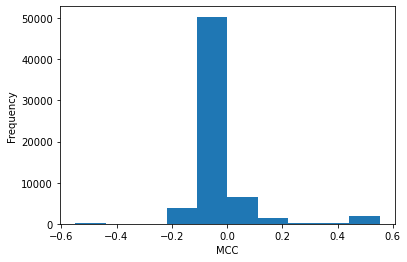

In [5]:
c_master_list = np.copy(result_matrix[:,0])
plt.hist(c_master_list,bins=10)
plt.xlabel('MCC')
plt.ylabel('Frequency')
plt.show()

To sort by MCC, use index = 0 below

f2 use index = 7

f1, index = 8

balanced average, index = 9

Kendall's Tau, index=10

In [6]:
index = 0
for i in range(len(result_matrix[:,10])):
    if np.isnan(result_matrix[i,10]) == True:
        result_matrix[i,10] = -2 # Removing nans because argsort() is ranking nans the highest
sorted_array = result_matrix[result_matrix[:,index].argsort()]
sorted_matrix = conf_matrix[result_matrix[:,index].argsort()]
sorted_pairs = pair_matrix[result_matrix[:,index].argsort()]

In [14]:
headers = ['C','Start Time','No Alert Time','Precut Magnitude','Distance Threshold','Alert Threshold','Time Step']
table = tabulate(sorted_array[-10:,[0,1,2,3,4,5,6]],headers=headers,tablefmt='simple')
print(table)

       C    Start Time    No Alert Time    Precut Magnitude    Distance Threshold    Alert Threshold    Time Step
--------  ------------  ---------------  ------------------  --------------------  -----------------  -----------
0.552506            20             0.05                -1                     2                   15         0.5
0.552506          1971             0.1                  1.5                   2.5                  5         0.75
0.552506          1971             0.05                 1                     1.5                 15         1
0.552506            15             0.1                  1                     2                    5         1
0.552506            20             0.05                 1                     2                    5         0.75
0.552506            20             0.05                 1                     2                   10         0.75
0.552506            20             0.05                 1                     2                

In [8]:
headers1 = ['TP','TNP','FP','FTP','N','E','Ins']
table1 = tabulate(sorted_matrix[-12:,:],headers=headers1,tablefmt='simple')
print(table1)

  TP    TNP    FP    FTP    N    E    Ins
----  -----  ----  -----  ---  ---  -----
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20
   1      1     0      0    0    6     20


Table of Earthquake Pairs

I-GK = Gardner Knopoff Window ended before the end-time (threat has passed), I-2 = The initial event was a foreshock and the mainshock occurred before the current end time, so this alert is meaningless. Both I-GK and I-2 are grouped with insufficient data for the score calculation. I = insufficient data

In [16]:
headers2 = ['5.32','5.41','5.6','5.6','Rid1','Rid2']
table2 = tabulate(sorted_pairs[-10:,0:6],headers=headers2,tablefmt='simple')
print(table2)

5.32    5.41    5.6    5.6    Rid1    Rid2
------  ------  -----  -----  ------  ------
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E
I-2     I       I-2    TNP    TP      E


In [10]:
col_list = []
for row in range(len(sorted_pairs[:,0])):
    for col in range(len(sorted_pairs[0,:])):
        if sorted_pairs[row,col] == 'TP':
            if col not in col_list:
                col_list.append(col)
print(col_list) #Only ever get ridgecrest

[4]


Count frequency of the parameter choices

In [11]:
print('st: 1971',np.count_nonzero(sorted_array[-241:,1] == 1971))
print('st: 5',np.count_nonzero(sorted_array[-241:,1] == 5))
print('st: 10',np.count_nonzero(sorted_array[-241:,1] == 10))
print('st: 15',np.count_nonzero(sorted_array[-241:,1] == 15))
print('st: 20',np.count_nonzero(sorted_array[-241:,1] == 20))
print('st: auto',np.count_nonzero(sorted_array[-241:,1] == -1))

print('na: 0.05',np.count_nonzero(sorted_array[-241:,2] == 0.05))
print('na: 0.1',np.count_nonzero(sorted_array[-241:,2] == 0.1))
print('na: 0.5',np.count_nonzero(sorted_array[-241:,2] == 0.5))
print('na: 1',np.count_nonzero(sorted_array[-241:,2] == 1))
print('na: auto',np.count_nonzero(sorted_array[-241:,2] == -1))

print('pc: 1',np.count_nonzero(sorted_array[-241:,3] == 1))
print('pc: 1.5',np.count_nonzero(sorted_array[-241:,3] == 1.5))
print('pc: 2',np.count_nonzero(sorted_array[-241:,3] == 2))
print('pc: auto',np.count_nonzero(sorted_array[-241:,3] == -1))

print('dt: 1',np.count_nonzero(sorted_array[-241:,4] == 1))
print('dt: 1.5',np.count_nonzero(sorted_array[-241:,4] == 1.5))
print('dt: 2',np.count_nonzero(sorted_array[-241:,4] == 2))
print('dt: 2.5',np.count_nonzero(sorted_array[-241:,4] == 2.5))
print('dt: 3',np.count_nonzero(sorted_array[-241:,4] == 3))
print('dt: auto',np.count_nonzero(sorted_array[-241:,4] == -1))

print('at: 5',np.count_nonzero(sorted_array[-241:,5] == 5))
print('at: 10',np.count_nonzero(sorted_array[-241:,5] == 10))
print('at: 15',np.count_nonzero(sorted_array[-241:,5] == 15))
print('at: 20',np.count_nonzero(sorted_array[-241:,5] == 20))
print('at: 25',np.count_nonzero(sorted_array[-241:,5] == 25))


st: 1971 52
st: 5 0
st: 10 25
st: 15 53
st: 20 52
st: auto 59
na: 0.05 132
na: 0.1 108
na: 0.5 1
na: 1 0
na: auto 0
pc: 1 70
pc: 1.5 71
pc: 2 0
pc: auto 100
dt: 1 0
dt: 1.5 33
dt: 2 117
dt: 2.5 54
dt: 3 31
dt: auto 6
at: 5 77
at: 10 78
at: 15 78
at: 20 7
at: 25 1
